In [3]:
library(dplyr)
library(ggplot2)
library(RColorBrewer)
library(forcats)

In [2]:
filename = "/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_neuroseq/May2021/genetic_effect/scaled_absolute_eff_sizes_tsne_as_spatial_cluster_labels.csv"
df_clusters = read.csv(filename, row.names = 1)

In [4]:
nrow(df_clusters)
head(df_clusters,2)

[1] 212

,label,gene,pp0,pp1,pp2,pp3,pp4,pp5,pp6,pp7,pp8,pp9,pp10,pp11,pp12,pp13,pp14
0,14,ABHD10_-3_111697439_T_G,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1
1,12,ABHD12B_-14_51328222_C_T,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0


In [5]:
for (i in 1:nrow(df_clusters)){
    s = sum(df_clusters[i,3:ncol(df_clusters)])
    if (s!=1){
        print(c(i, s))
    }
}

In [6]:
df0 = data.frame()
for (label in unique(df_clusters$label)){
    df0 = rbind(df0, data.frame(cluster = label, n_genes = nrow(df_clusters[df_clusters$label == label,])))                            
}

In [7]:
df0[order(df0$n_genes, decreasing = T),]

,cluster,n_genes
1,14,36
3,0,30
11,13,20
2,12,19
9,7,18
12,10,16
7,5,15
10,3,11
4,1,10
8,11,8


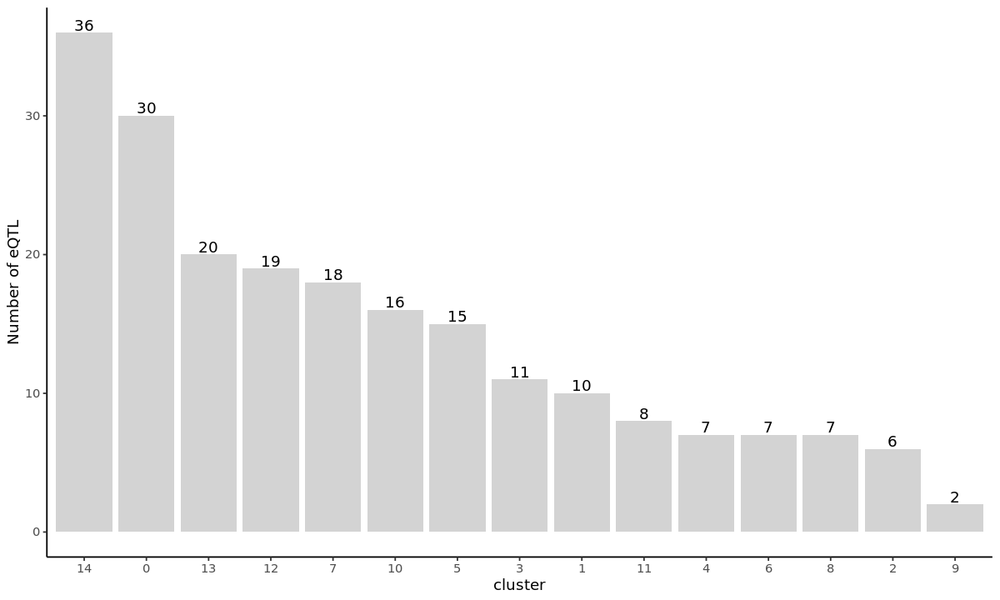

In [8]:
options(repr.plot.width = 10, repr.plot.height = 6)
df0$cluster = as.factor(df0$cluster)
df0 %>%
  mutate(cluster = fct_reorder(cluster, desc(n_genes))) %>%
  ggplot(aes(x=cluster, y=n_genes)) +
    geom_bar(stat="identity", fill = "lightgrey") + 
    geom_text(aes(label = n_genes), vjust = -0.2) +
#     geom_text(aes(label=..count..),stat='count',position=position_dodge(0.9),vjust=-0.2) +
    xlab("cluster") + ylab("Number of eQTL") +
    theme_classic()

In [9]:
df = read.csv("/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_neuroseq/May2021/genetic_effect/MOFA10/eqtl_tot_genetic_effect_all.txt", sep="\t",row.names = 1)
df_pcs = read.csv("/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_neuroseq/May2021/mofa_logcounts_model_factors.csv", row.names = 1)

In [10]:
df_pcs = read.csv("/hps/nobackup/stegle/users/acuomo/all_scripts/struct_LMM2/sc_neuroseq/May2021/mofa_tsne.csv", row.names=1)

In [11]:
nrow(df)
nrow(df_pcs)

[1] 8352

[1] 9219

In [12]:
cells0 = rownames(df)
df_pcs = df_pcs[cells0,]

In [13]:
head(df,2)

,ABHD10_.3_111697439_T_G,ABHD12B_.14_51328222_C_T,ACKR2_.3_42817129_C_T,ADD2_.2_70894426_A_T,ADSL_.22_40757228_A_C,AIM1L_.1_26673825_C_T,AKAP7_.6_131691964_C_A,ALDH7A1_.5_126011412_G_A,ANKRD18B_.9_33524775_C_A,APIP_.11_34905987_T_C,...,YWHAE_.17_1246420_G_A,ZBBX_.3_167080934_T_G,ZC3HAV1_.7_138730361_T_C,ZFR2_.19_3840157_C_T,ZG16B_.16_2871121_T_C,ZNF423_.16_49599995_C_G,ZNF552_.19_58315273_G_A,ZNF738_.19_21474173_G_A,ZNF77_.19_2936535_G_A,ZP3_.7_76177284_C_T
HPSI0714i-iudw_1--DA--d30--0,-0.2108622,0.003924475,0.02206444,0.02834211,0.2235163,-0.03575032,-0.09473256,0.006901295,0.0006737957,-0.07499119,...,0.06962421,0.1120253,-0.04172133,0.01126897,0.1057579,-0.03101814,0.0909417,0.3020245,-0.1583842,-0.05596878
HPSI0714i-iudw_1--DA--d30--1,-0.2283969,-0.047217741,0.10596178,0.02514689,-0.1921801,-0.01471768,0.01878961,-0.171038975,-0.1105473675,-0.18686595,...,-0.21070417,0.3759854,0.08774666,0.02505916,-0.1950055,-0.22780547,0.0775938,0.3452492,-0.3472152,-0.15259400


In [14]:
colnames(df) = gsub("_\\.","-",colnames(df))

In [15]:
head(df,2)

,ABHD10-3_111697439_T_G,ABHD12B-14_51328222_C_T,ACKR2-3_42817129_C_T,ADD2-2_70894426_A_T,ADSL-22_40757228_A_C,AIM1L-1_26673825_C_T,AKAP7-6_131691964_C_A,ALDH7A1-5_126011412_G_A,ANKRD18B-9_33524775_C_A,APIP-11_34905987_T_C,...,YWHAE-17_1246420_G_A,ZBBX-3_167080934_T_G,ZC3HAV1-7_138730361_T_C,ZFR2-19_3840157_C_T,ZG16B-16_2871121_T_C,ZNF423-16_49599995_C_G,ZNF552-19_58315273_G_A,ZNF738-19_21474173_G_A,ZNF77-19_2936535_G_A,ZP3-7_76177284_C_T
HPSI0714i-iudw_1--DA--d30--0,-0.2108622,0.003924475,0.02206444,0.02834211,0.2235163,-0.03575032,-0.09473256,0.006901295,0.0006737957,-0.07499119,...,0.06962421,0.1120253,-0.04172133,0.01126897,0.1057579,-0.03101814,0.0909417,0.3020245,-0.1583842,-0.05596878
HPSI0714i-iudw_1--DA--d30--1,-0.2283969,-0.047217741,0.10596178,0.02514689,-0.1921801,-0.01471768,0.01878961,-0.171038975,-0.1105473675,-0.18686595,...,-0.21070417,0.3759854,0.08774666,0.02505916,-0.1950055,-0.22780547,0.0775938,0.3452492,-0.3472152,-0.15259400


In [16]:
head(df_pcs,2)

,tSNE1,tSNE2,condition
HPSI0714i-iudw_1--DA--d30--0,-13.756691,32.71191,d30
HPSI0714i-iudw_1--DA--d30--1,4.620292,31.43719,d30


In [17]:
cluster = "14"
# df_clusters[df_clusters$label == cluster,]
genes = gsub("_-","-",df_clusters[df_clusters$label == cluster,"gene"])

In [18]:
options(repr.plot.width = 5, repr.plot.height = 3)

In [19]:
range01 <- function(x){(x-min(x))/(max(x)-min(x))}

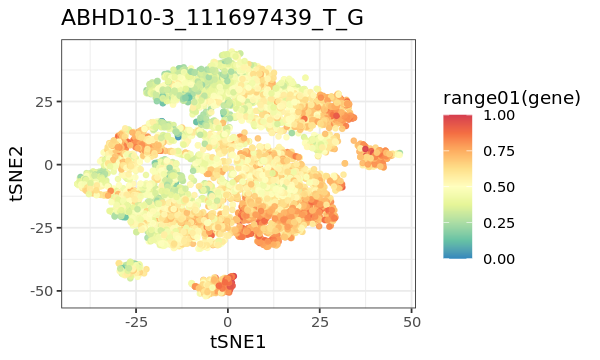

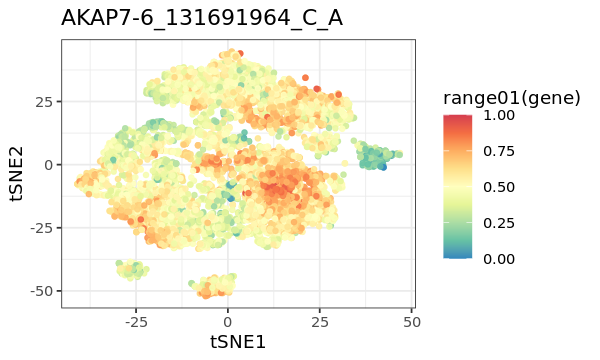

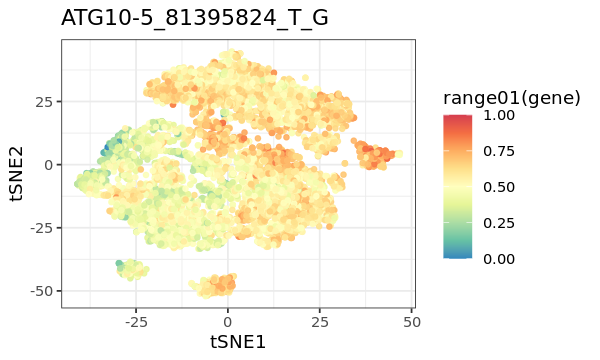

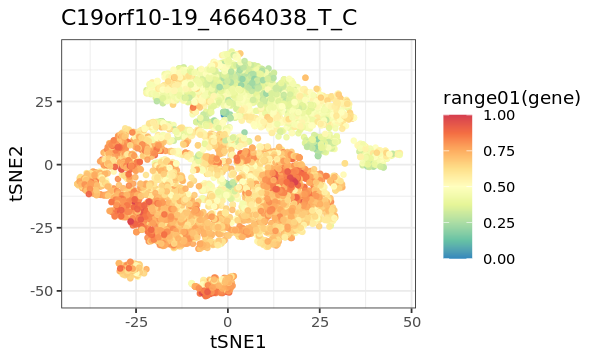

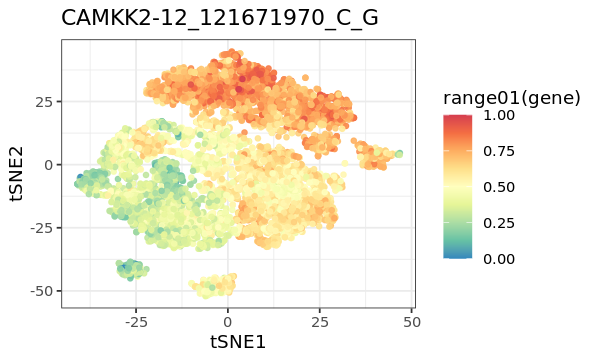

...

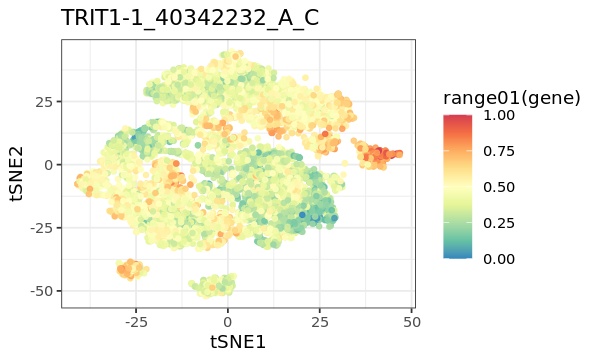

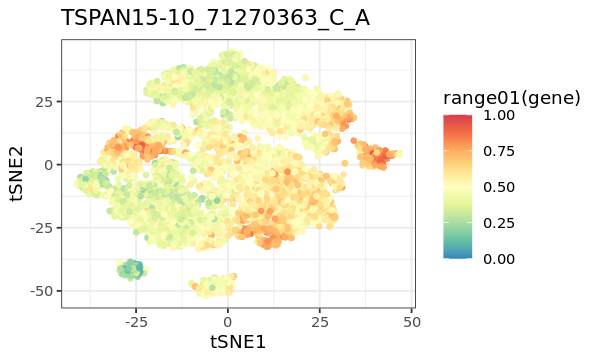

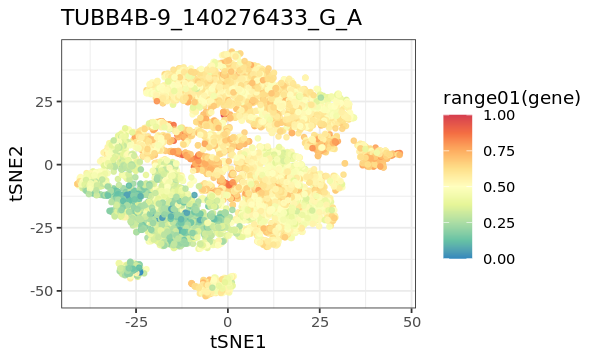

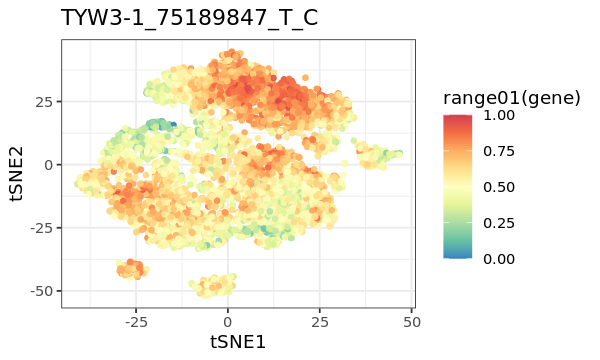

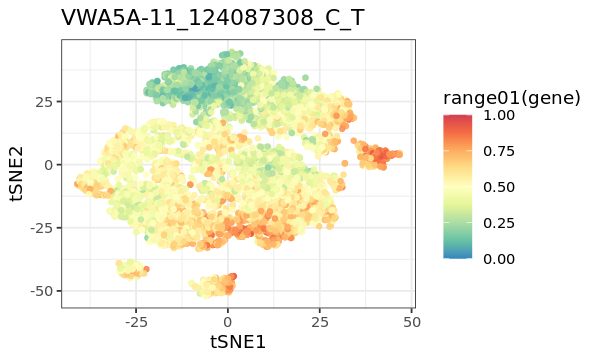

In [20]:
for (gene in genes){
#     print(gene)
    df_to_plot = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df[,gene]))
#     print(head(df_to_plot))
    p = ggplot(df_to_plot, aes(x = tSNE1, y = tSNE2, col = range01(gene))) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

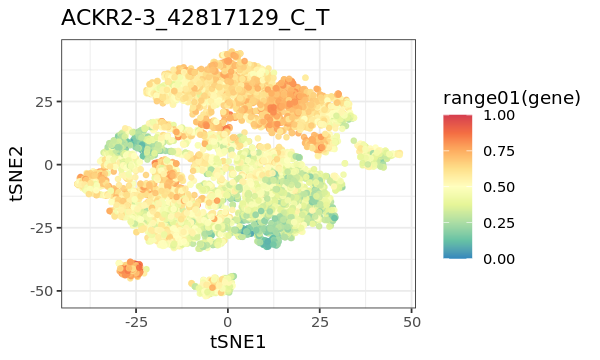

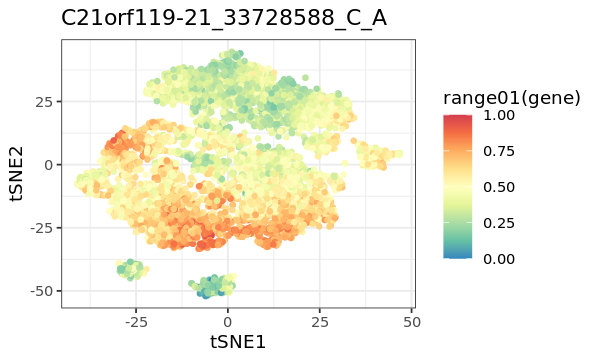

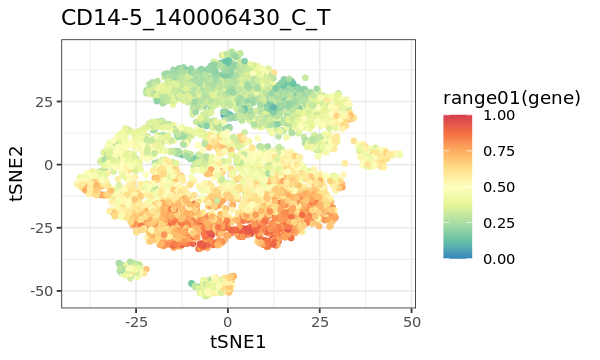

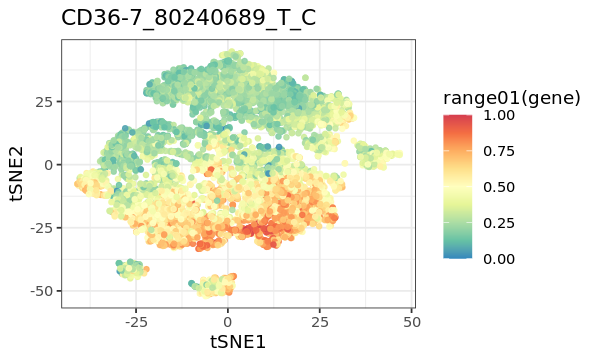

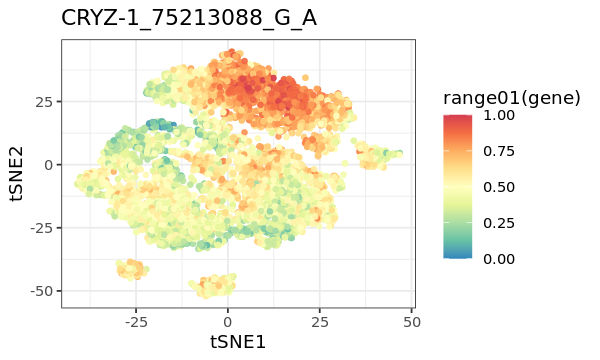

...

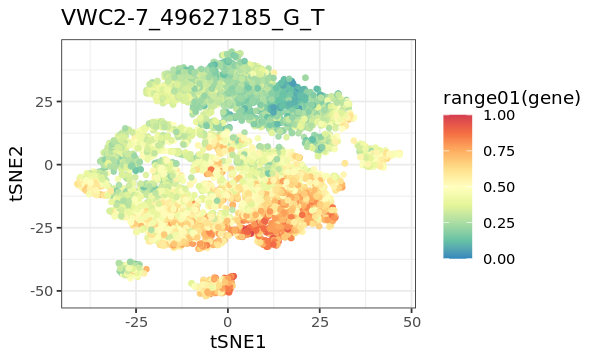

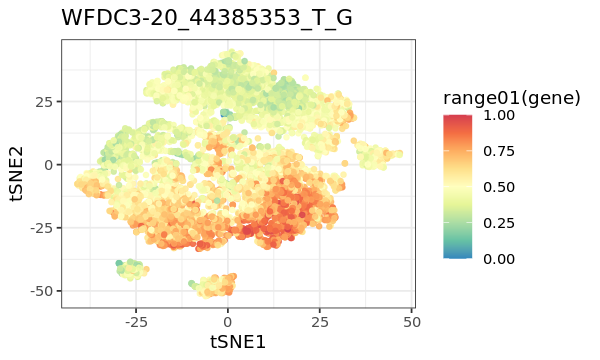

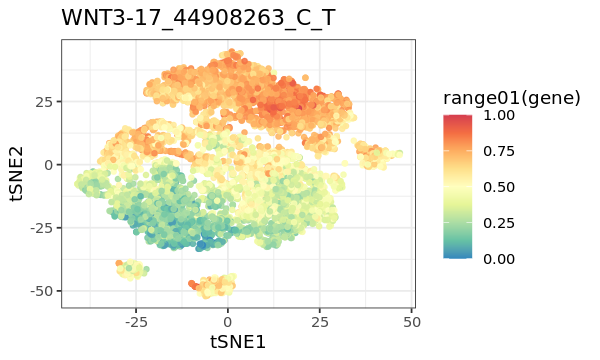

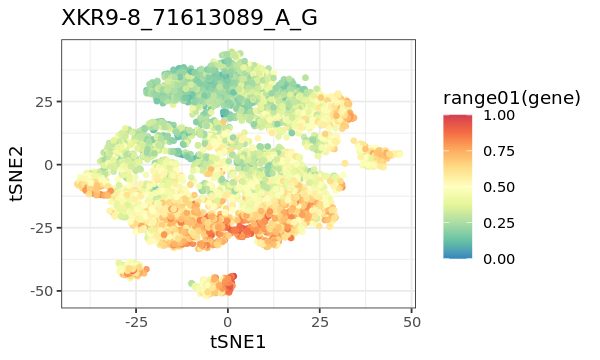

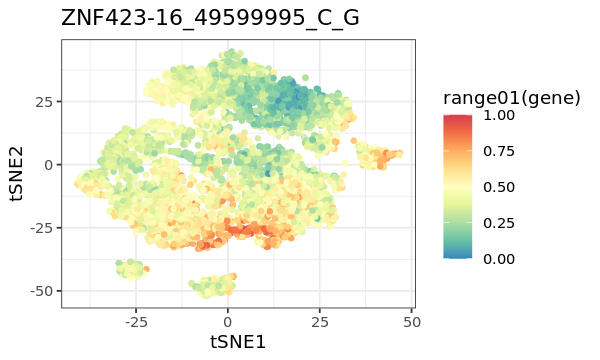

In [21]:
cluster='0'
genes = gsub("_-","-",df_clusters[df_clusters$label == cluster,"gene"])
for (gene in genes){
    df_to_plot = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = tSNE1, y = tSNE2, col = range01(gene))) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

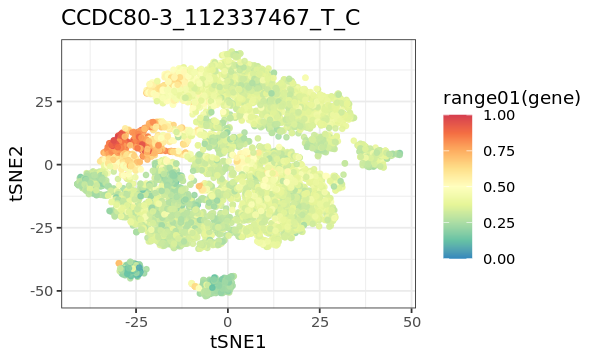

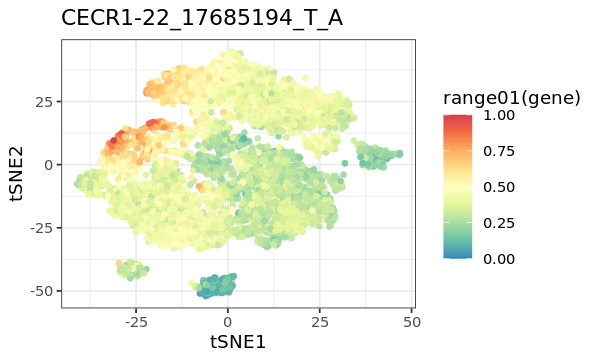

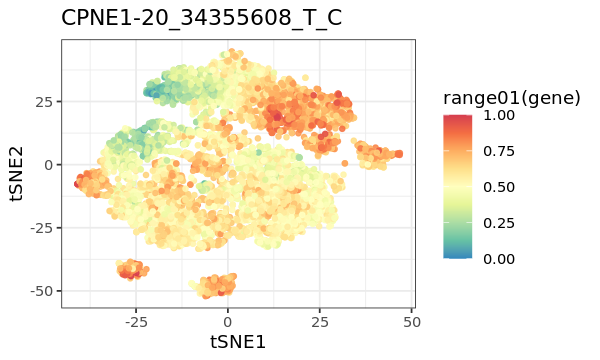

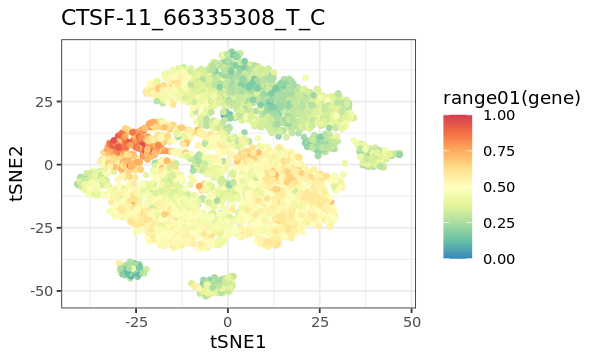

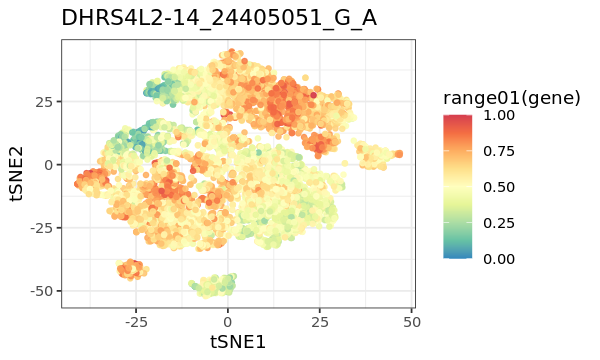

...

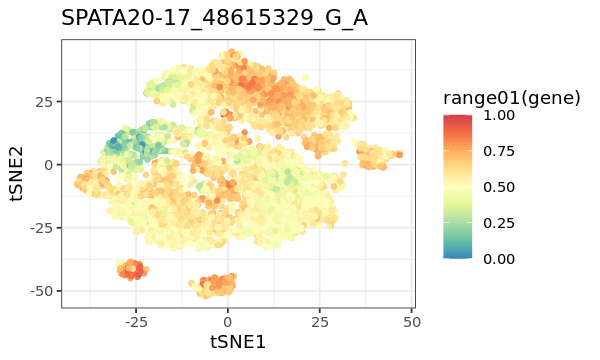

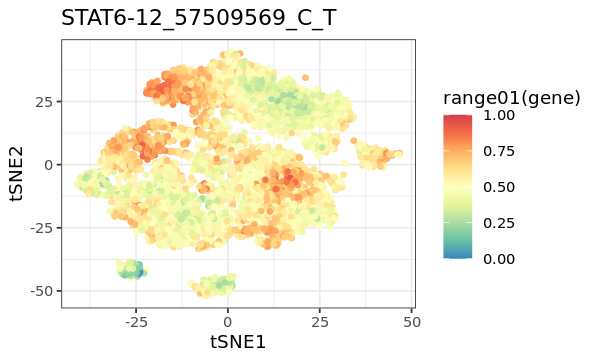

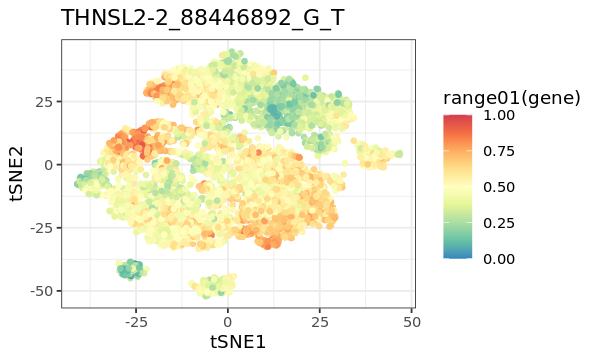

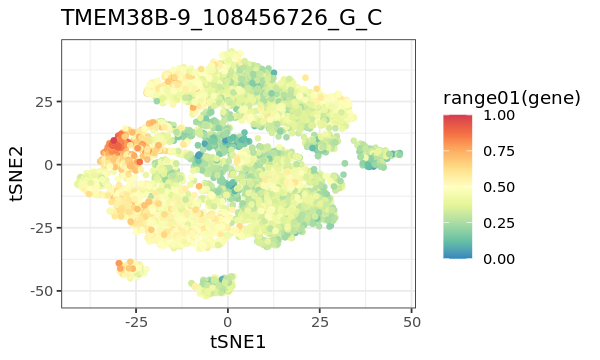

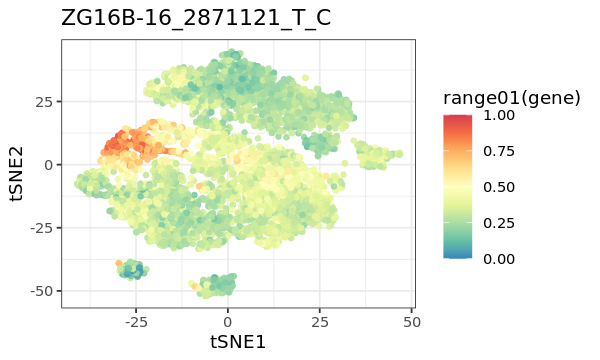

In [22]:
cluster='13'
genes = gsub("_-","-",df_clusters[df_clusters$label == cluster,"gene"])
for (gene in genes){
    df_to_plot = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = tSNE1, y = tSNE2, col = range01(gene))) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

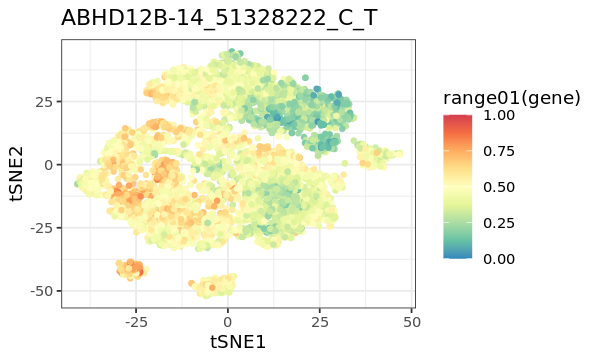

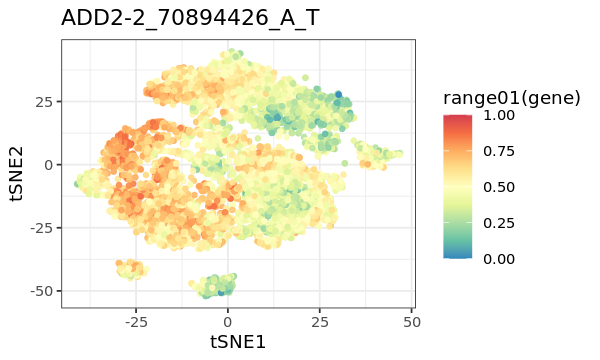

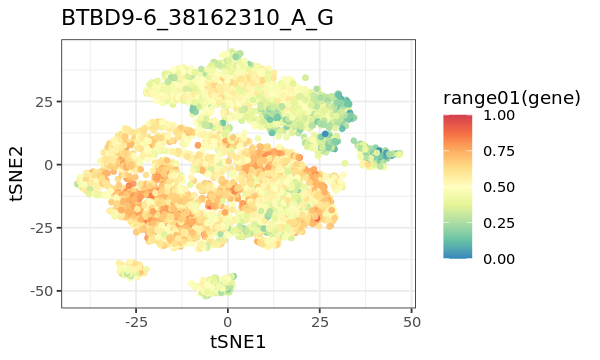

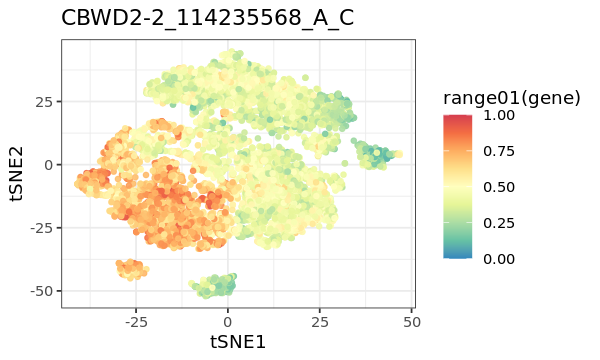

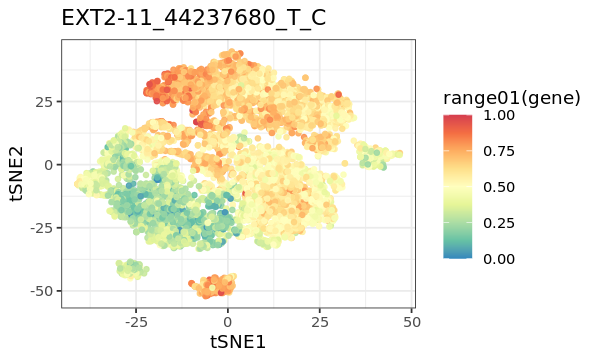

...

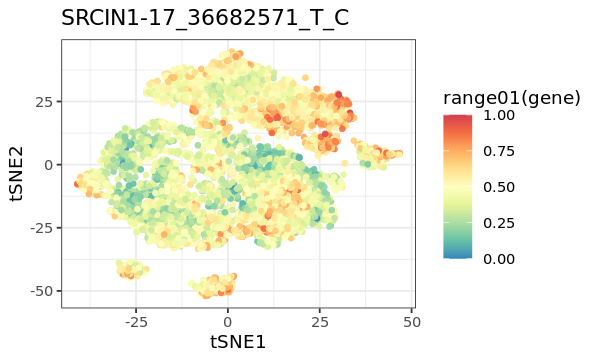

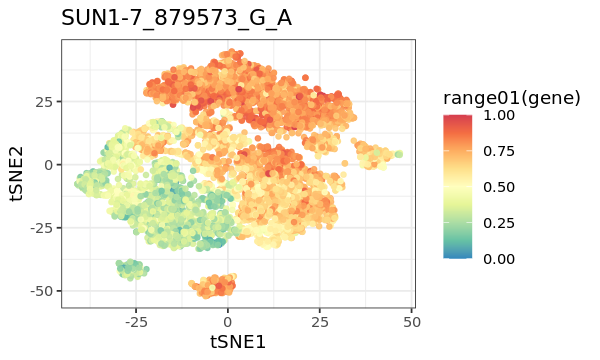

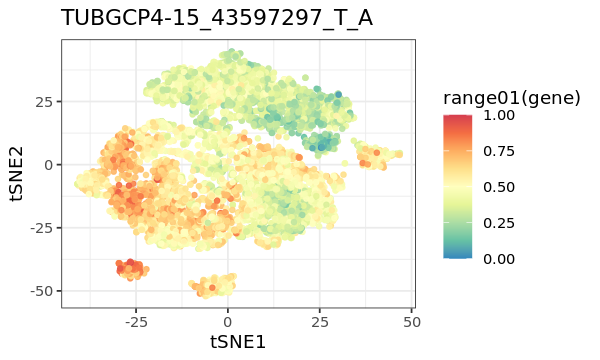

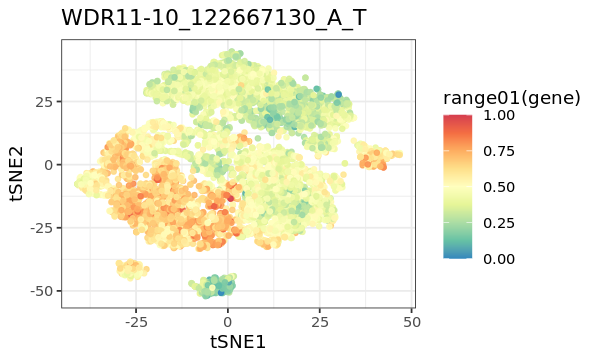

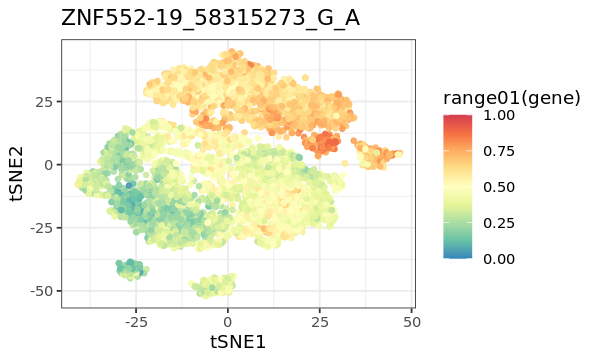

In [23]:
cluster='12'
genes = gsub("_-","-",df_clusters[df_clusters$label == cluster,"gene"])
for (gene in genes){
    df_to_plot = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = tSNE1, y = tSNE2, col = range01(gene))) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

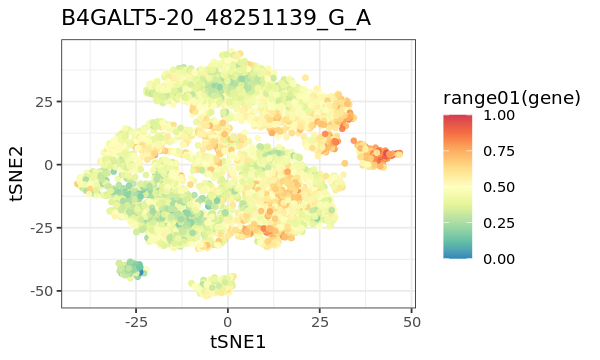

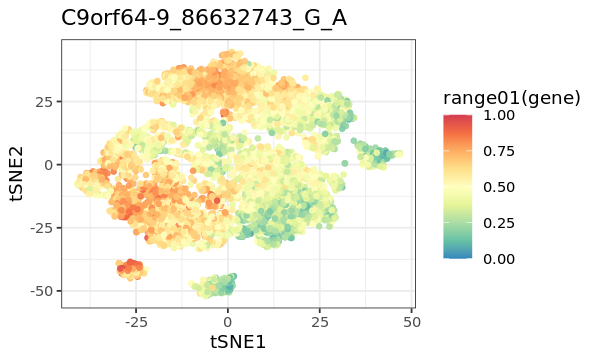

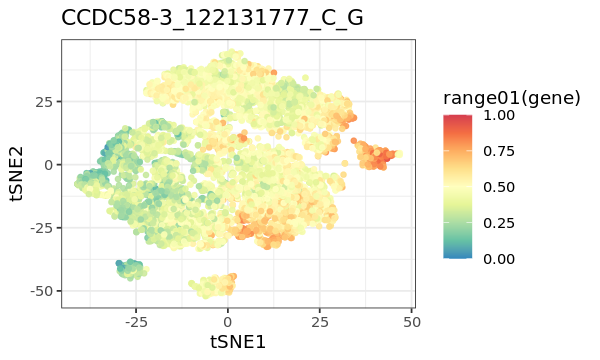

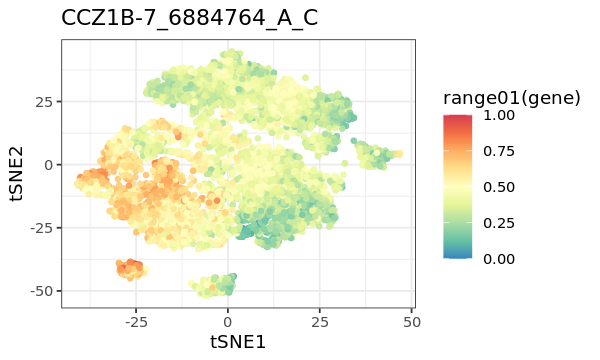

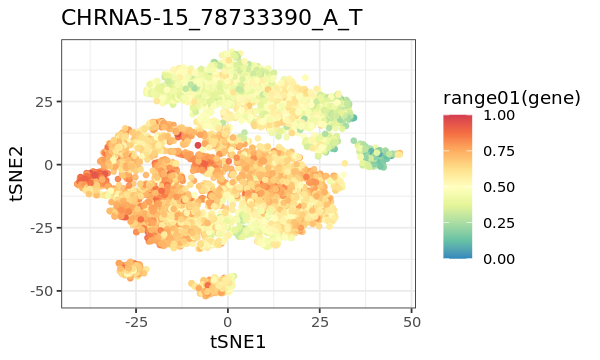

...

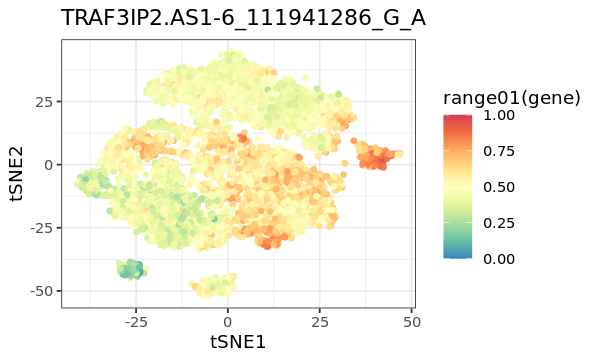

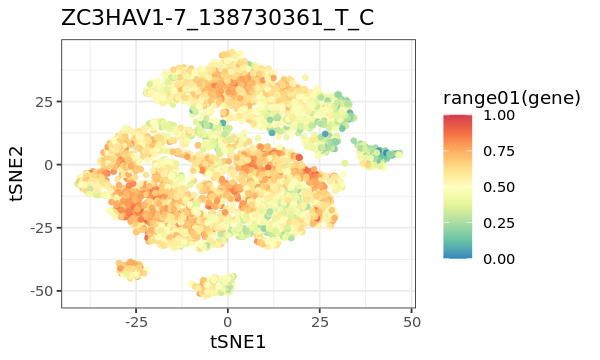

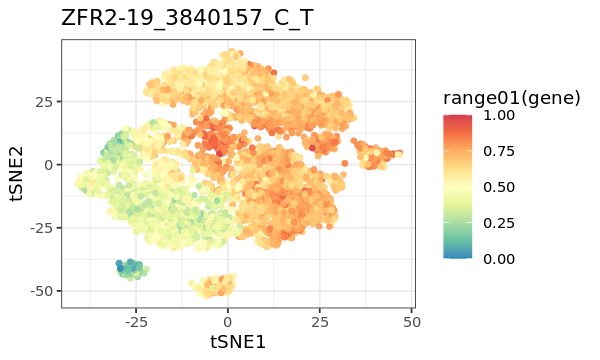

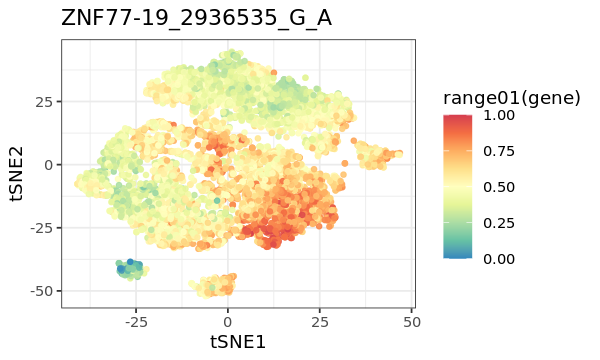

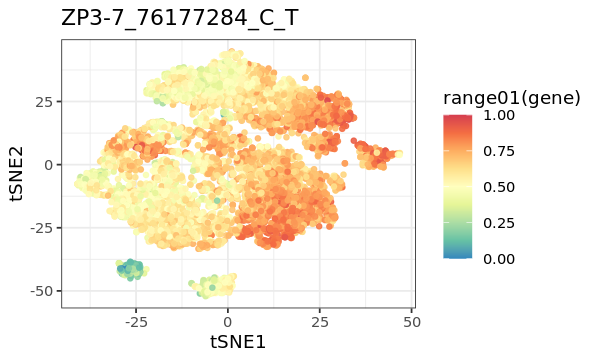

In [24]:
cluster='7'
genes = gsub("_-","-",df_clusters[df_clusters$label == cluster,"gene"])
for (gene in genes){
    df_to_plot = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = tSNE1, y = tSNE2, col = range01(gene))) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

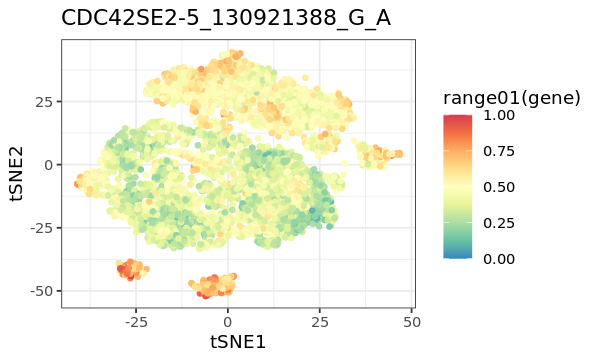

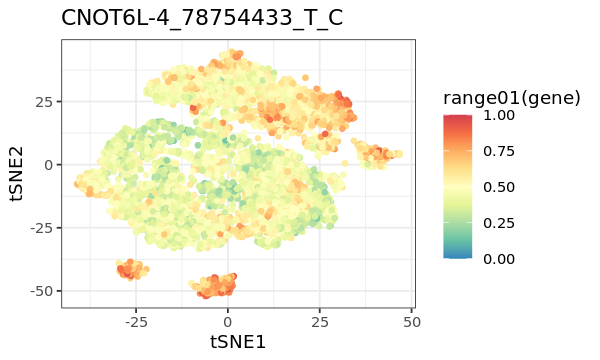

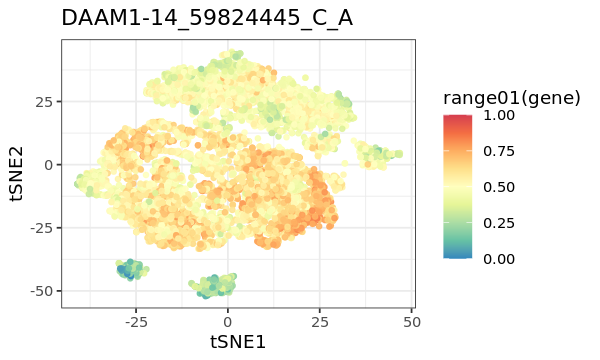

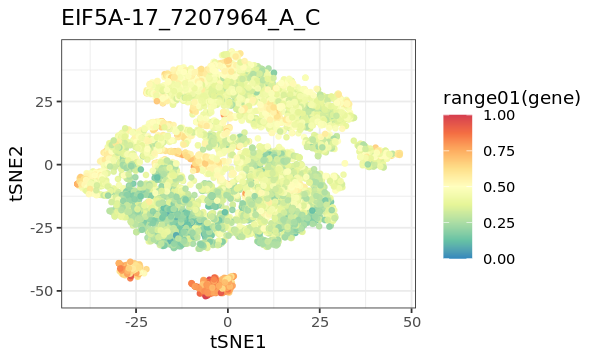

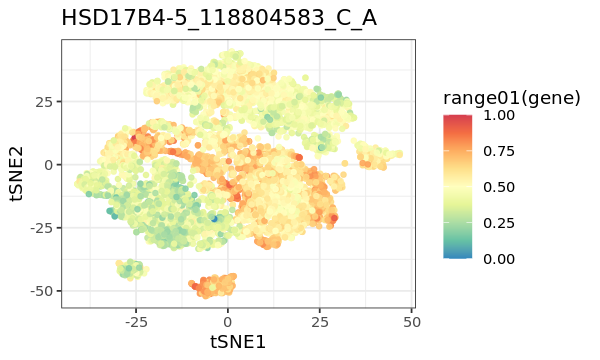

...

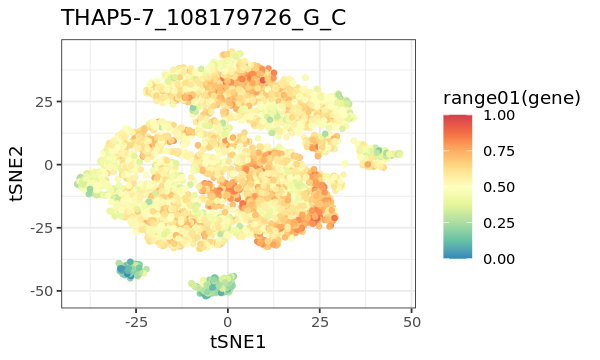

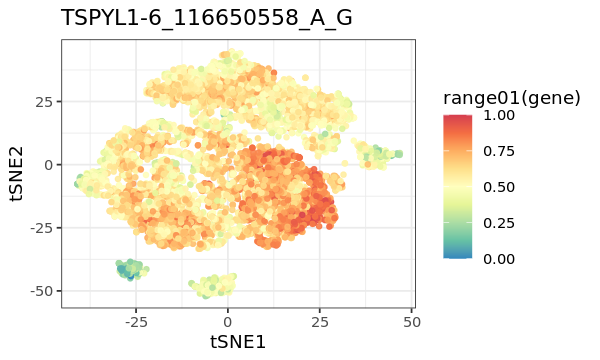

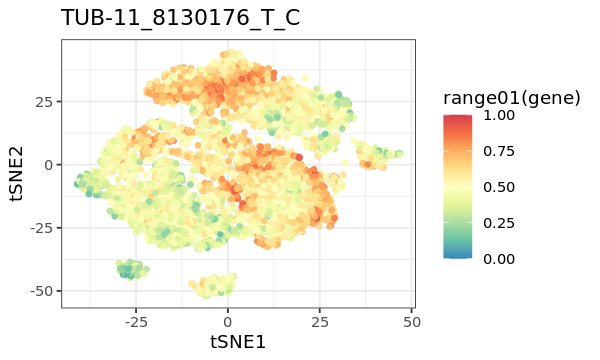

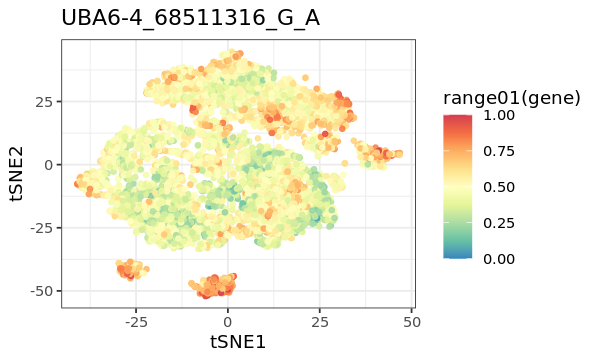

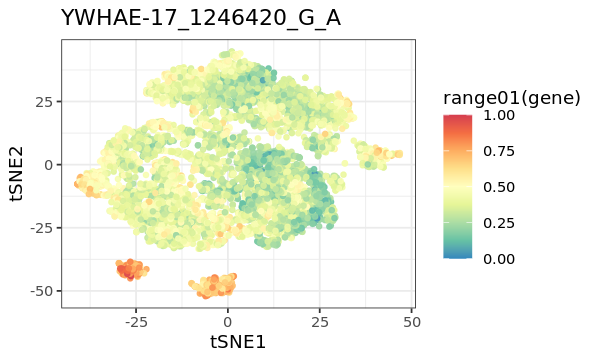

In [25]:
cluster='10'
genes = gsub("_-","-",df_clusters[df_clusters$label == cluster,"gene"])
for (gene in genes){
    df_to_plot = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = tSNE1, y = tSNE2, col = range01(gene))) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

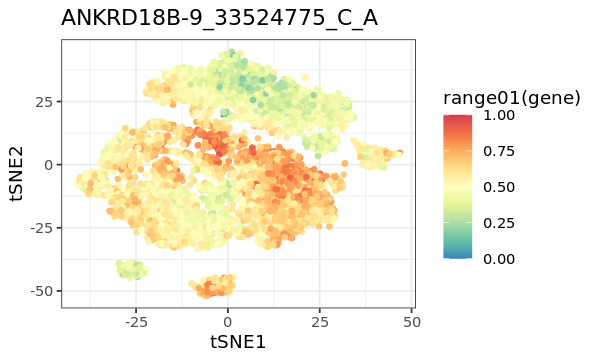

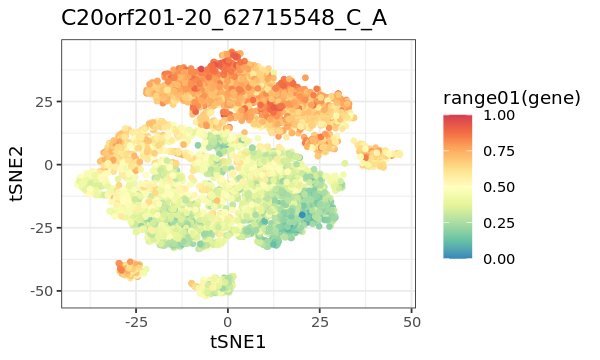

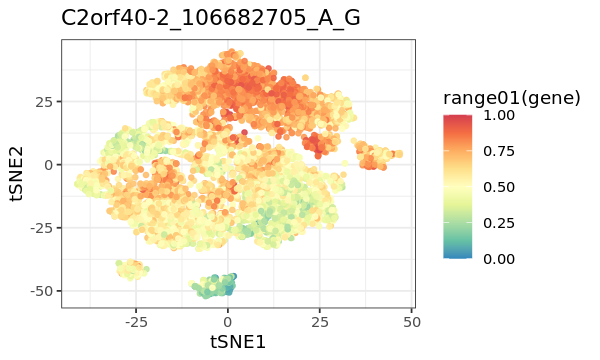

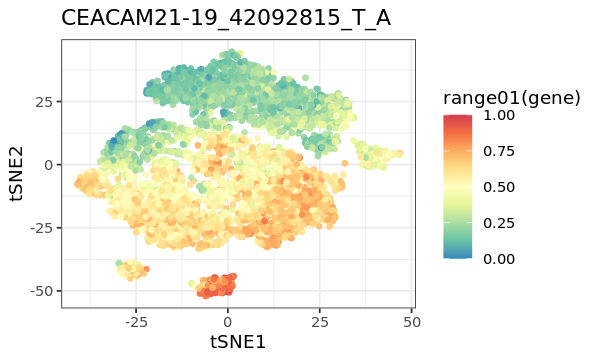

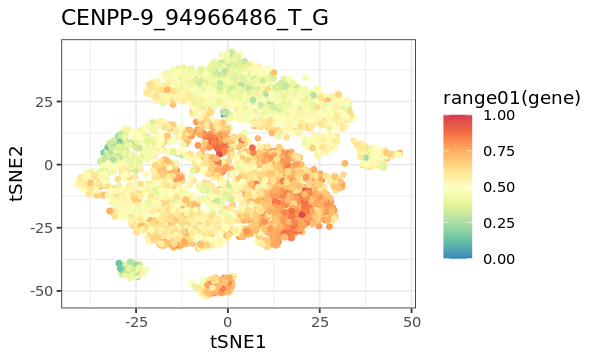

...

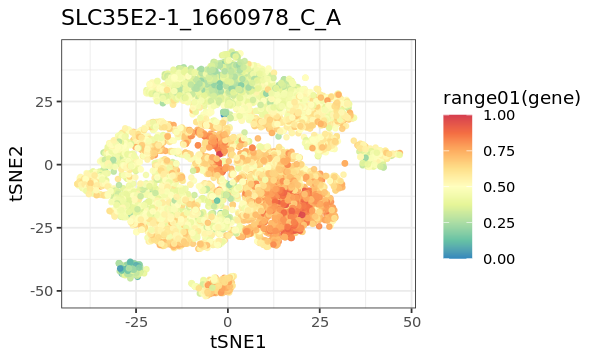

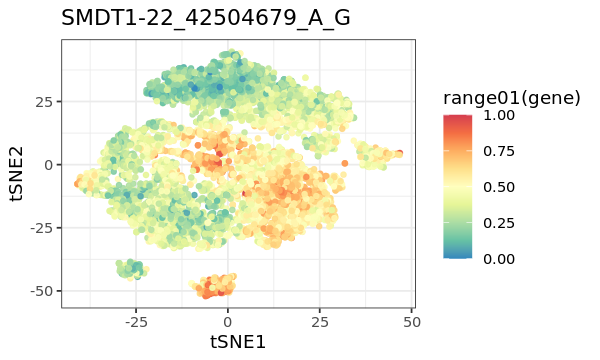

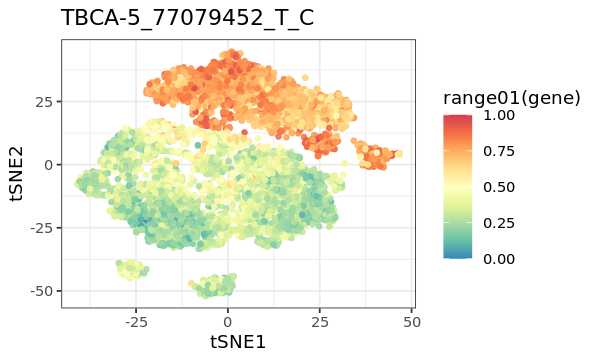

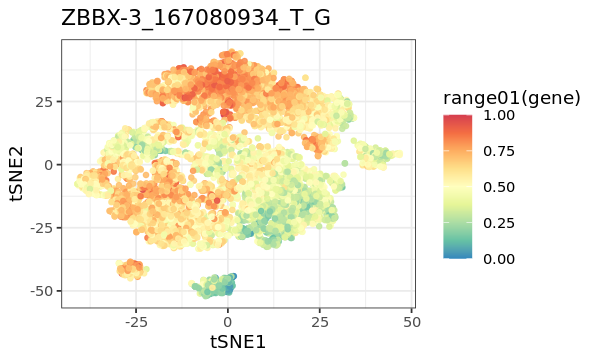

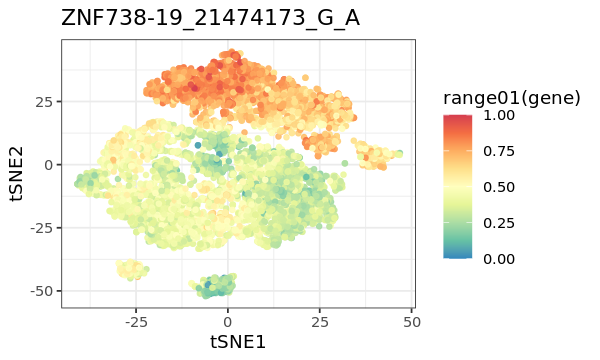

In [26]:
cluster='5'
genes = gsub("_-","-",df_clusters[df_clusters$label == cluster,"gene"])
for (gene in genes){
    df_to_plot = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = tSNE1, y = tSNE2, col = range01(gene))) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

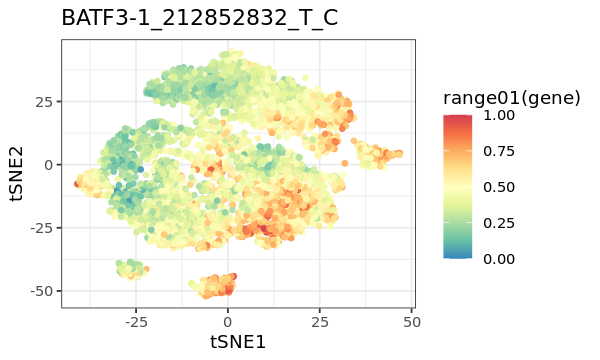

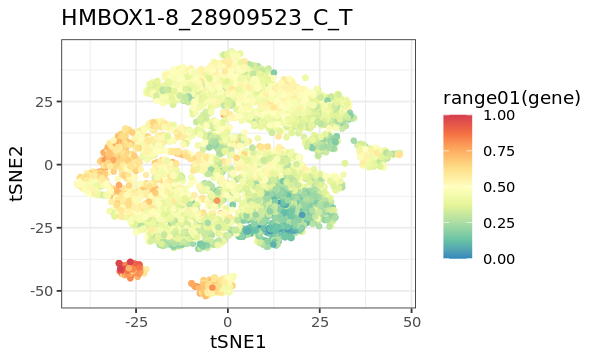

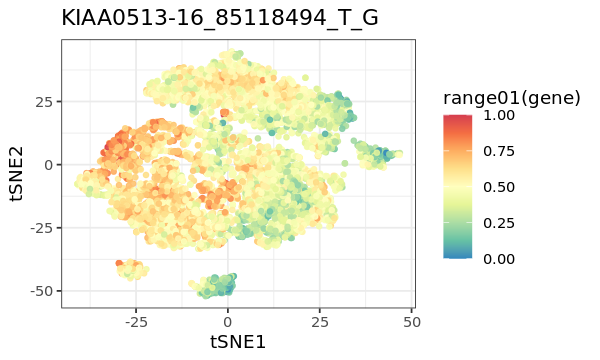

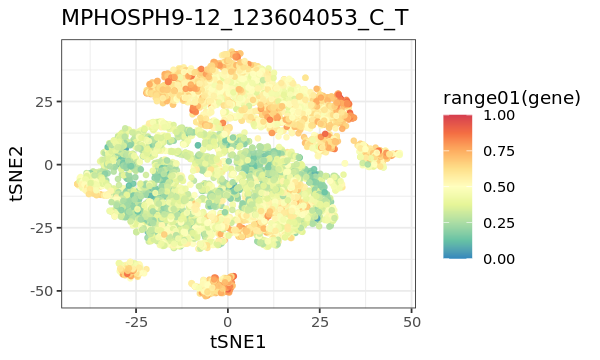

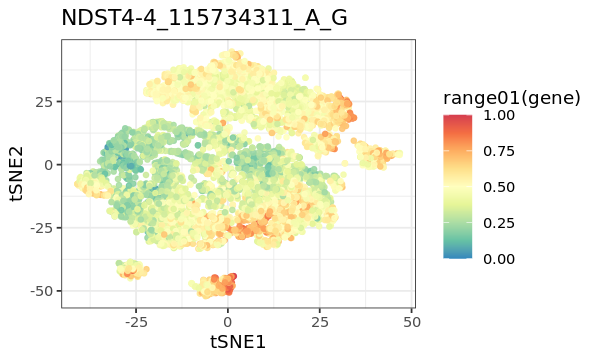

...

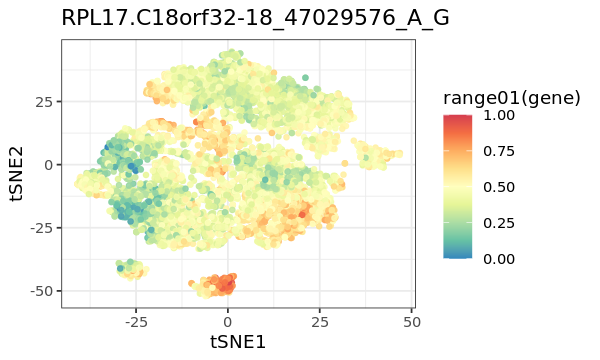

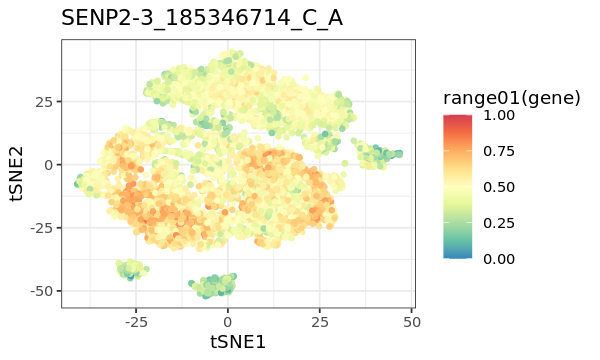

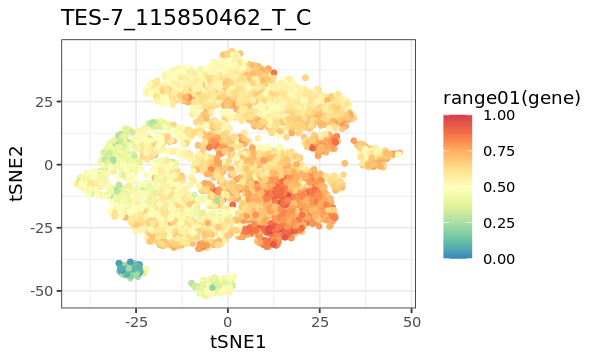

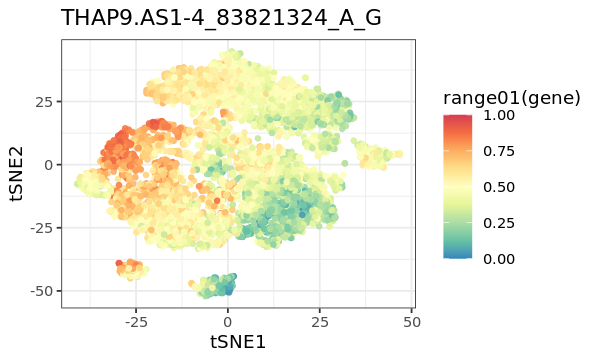

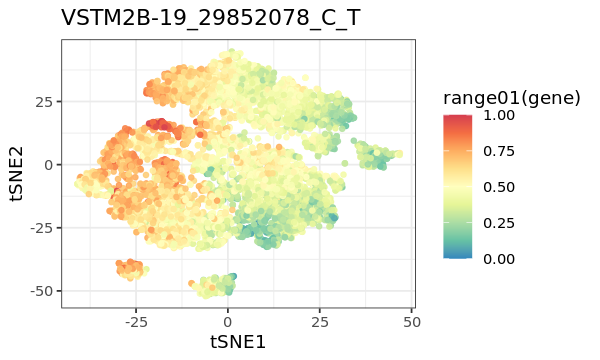

In [27]:
cluster='3'
genes = gsub("_-","-",df_clusters[df_clusters$label == cluster,"gene"])
for (gene in genes){
    df_to_plot = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = tSNE1, y = tSNE2, col = range01(gene))) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

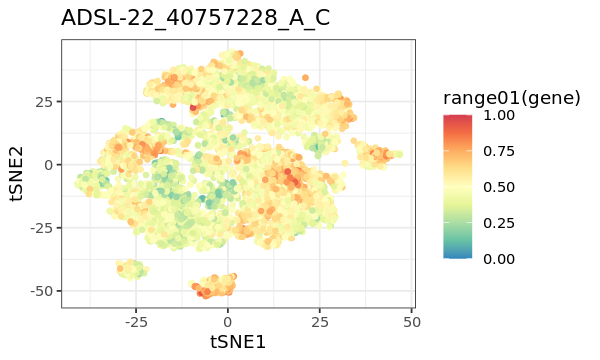

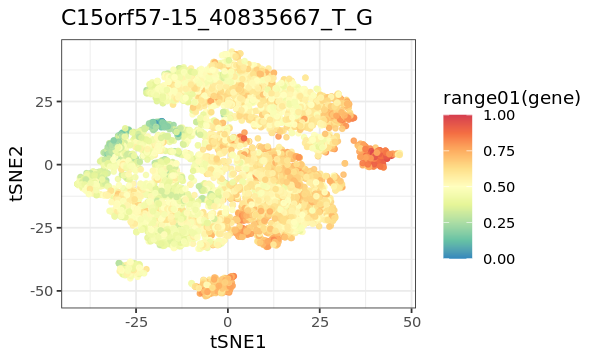

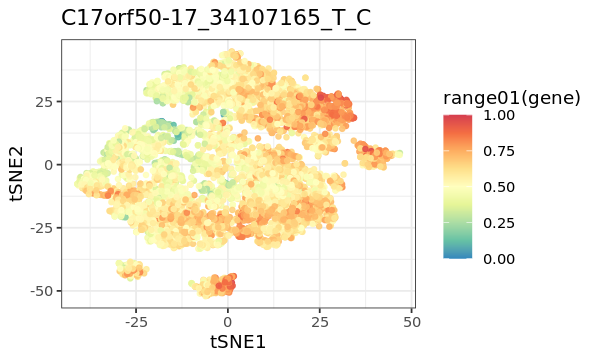

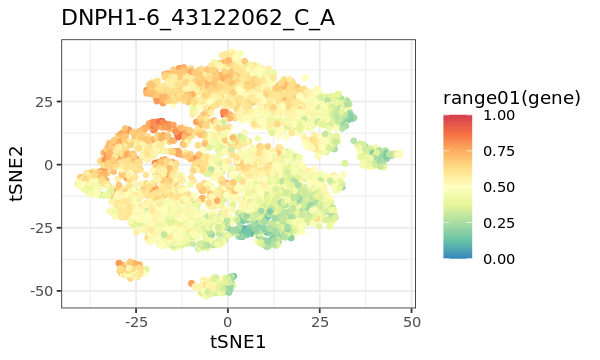

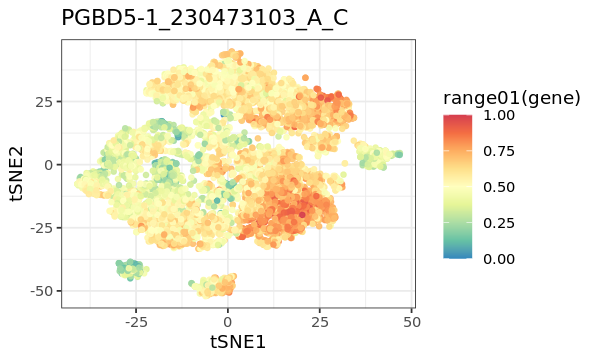

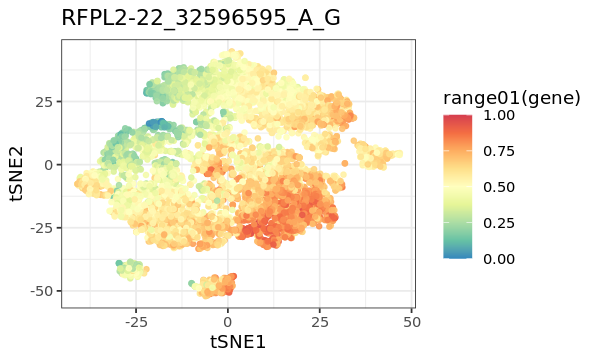

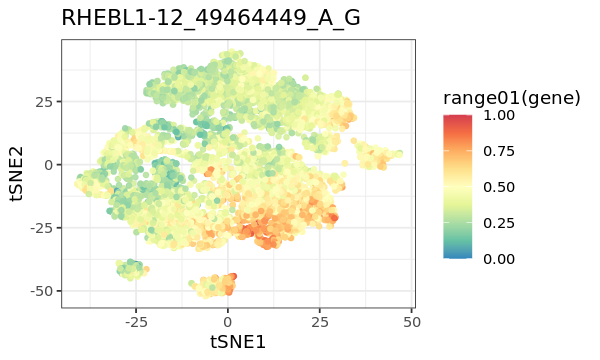

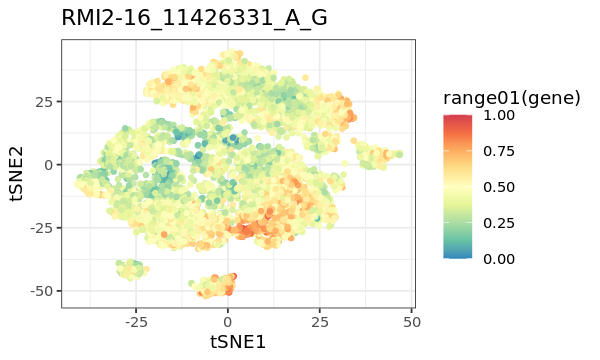

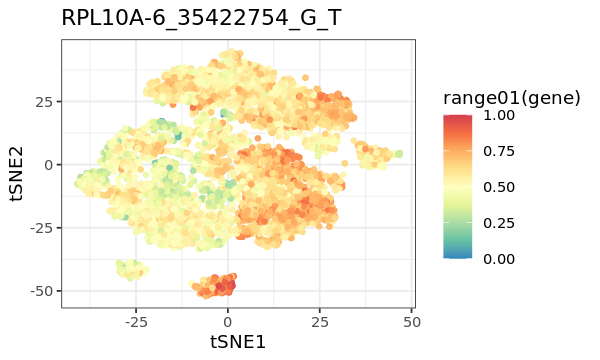

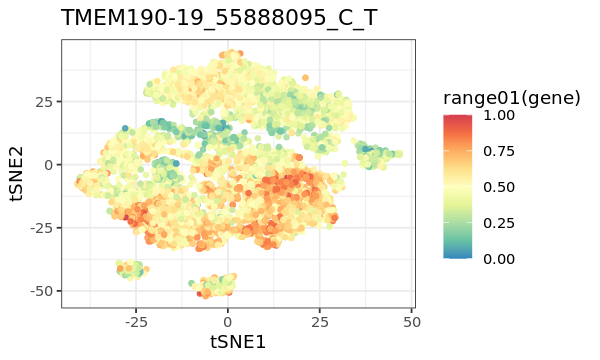

In [28]:
cluster='1'
genes = gsub("_-","-",df_clusters[df_clusters$label == cluster,"gene"])
for (gene in genes){
    df_to_plot = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = tSNE1, y = tSNE2, col = range01(gene))) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

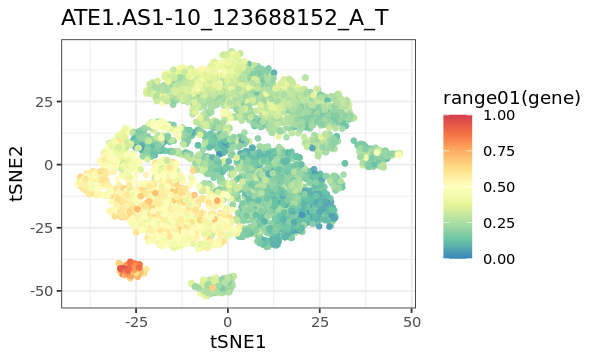

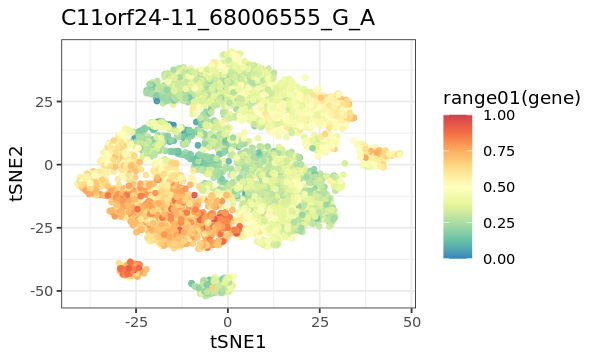

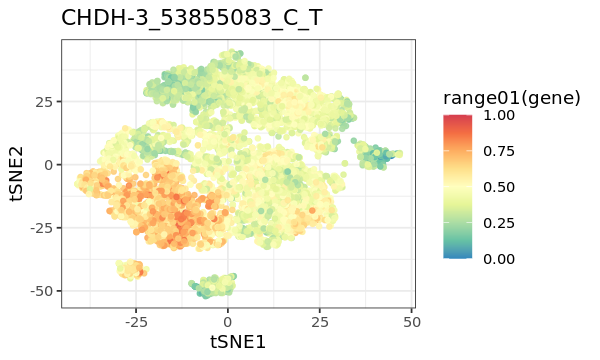

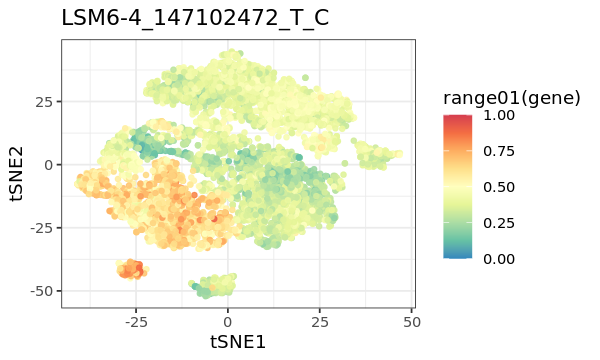

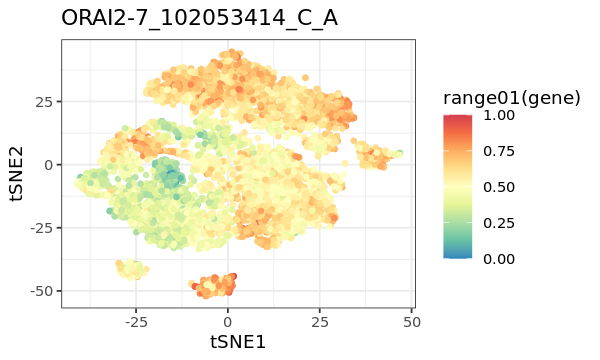

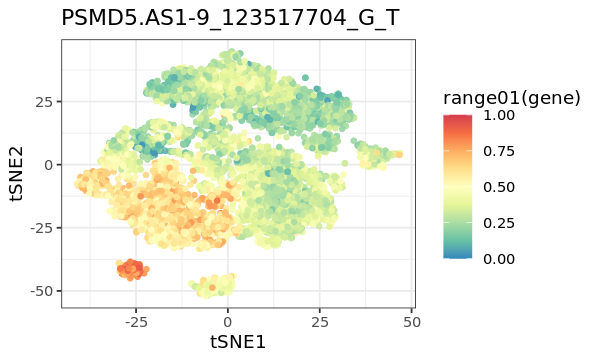

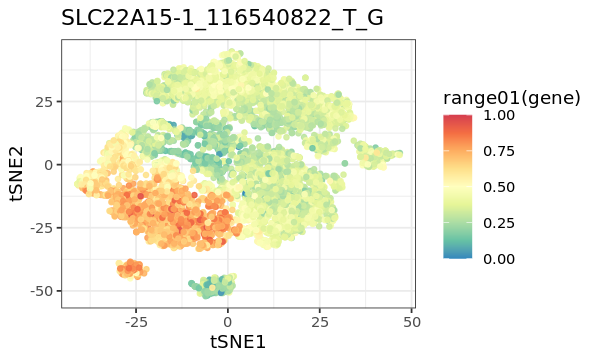

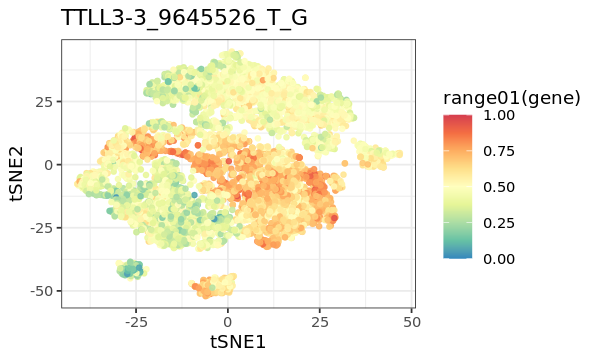

In [29]:
cluster='11'
genes = gsub("_-","-",df_clusters[df_clusters$label == cluster,"gene"])
for (gene in genes){
    df_to_plot = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = tSNE1, y = tSNE2, col = range01(gene))) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

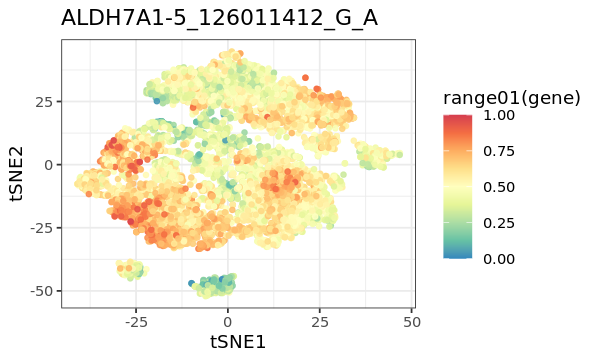

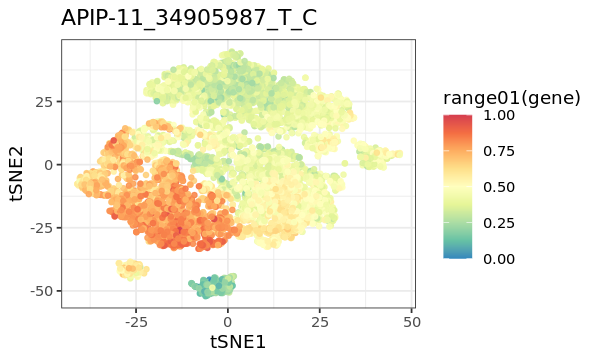

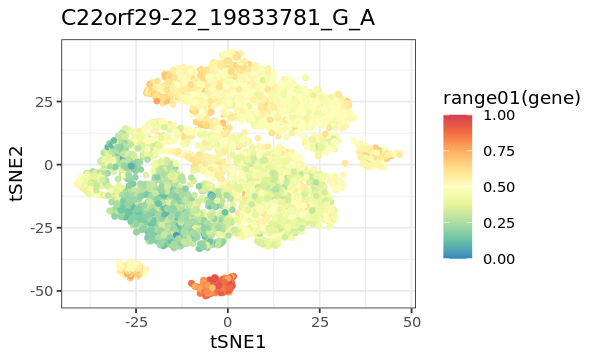

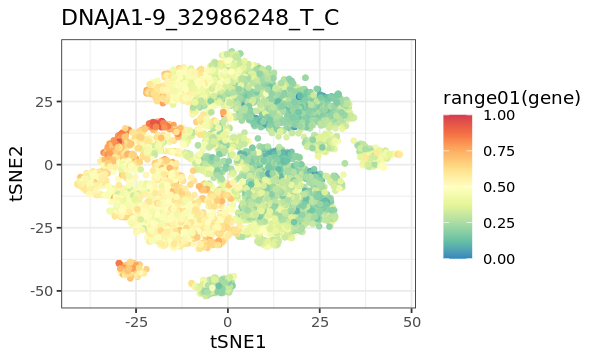

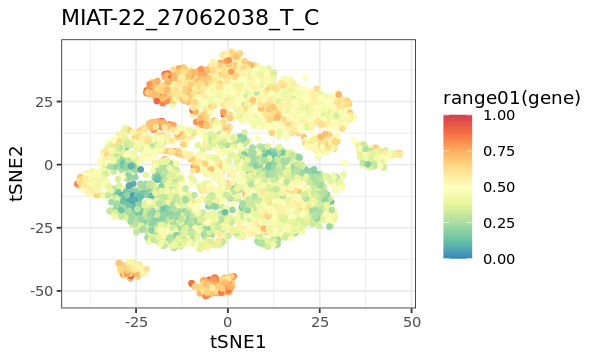

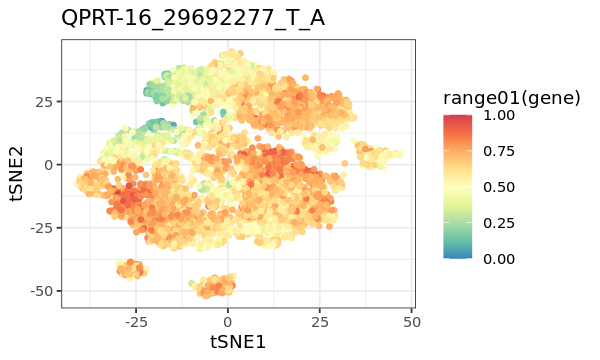

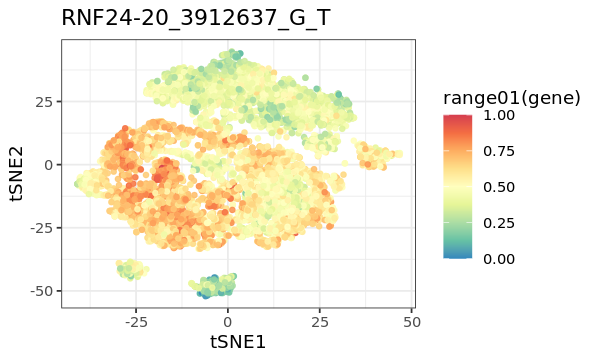

In [30]:
cluster='4'
genes = gsub("_-","-",df_clusters[df_clusters$label == cluster,"gene"])
for (gene in genes){
    df_to_plot = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = tSNE1, y = tSNE2, col = range01(gene))) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

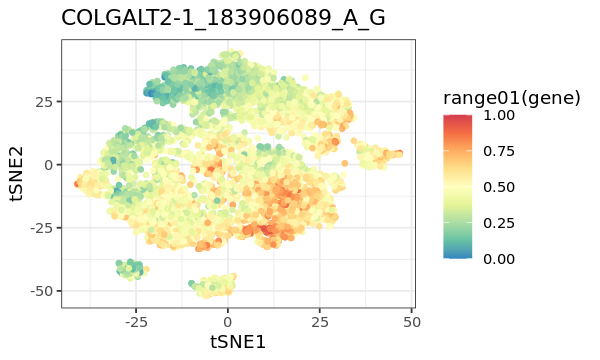

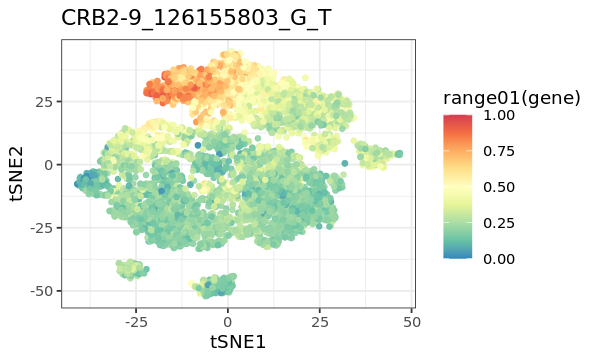

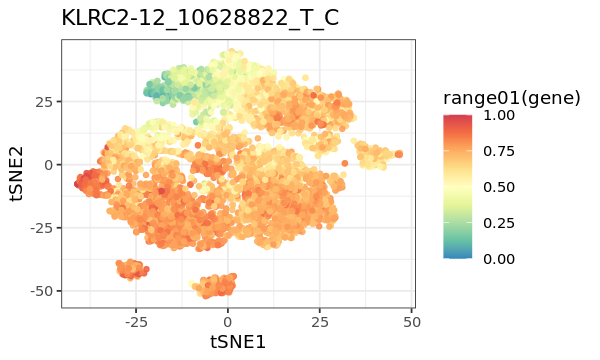

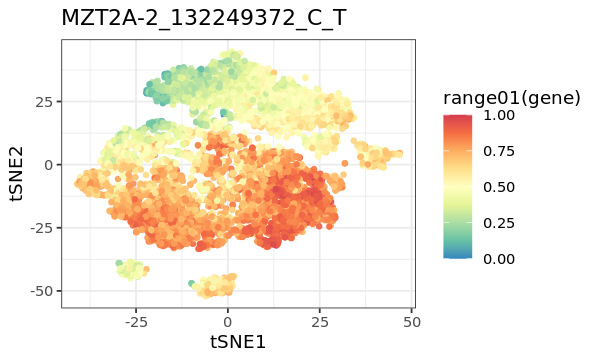

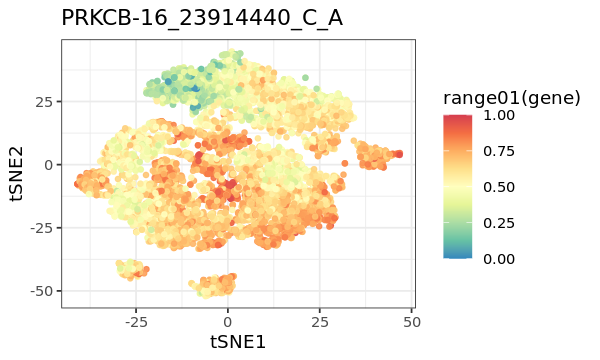

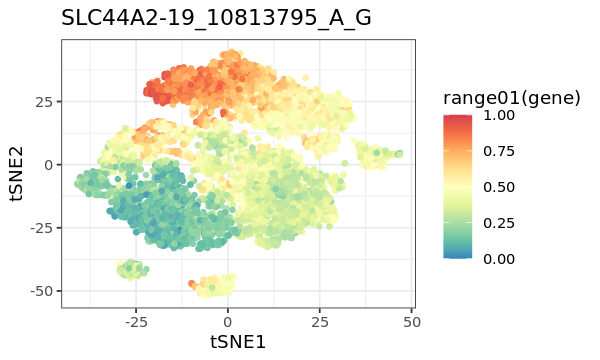

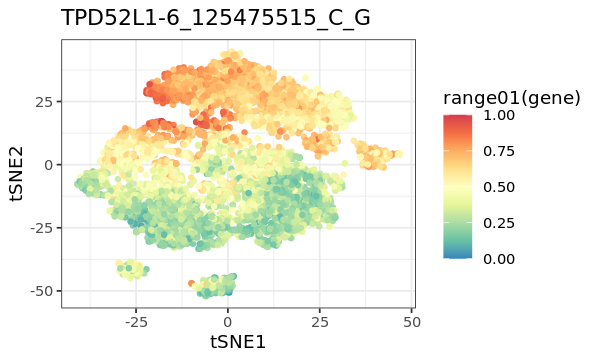

In [31]:
cluster='6'
genes = gsub("_-","-",df_clusters[df_clusters$label == cluster,"gene"])
for (gene in genes){
    df_to_plot = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = tSNE1, y = tSNE2, col = range01(gene))) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

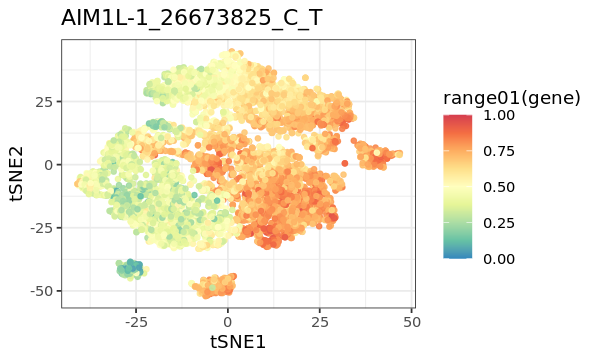

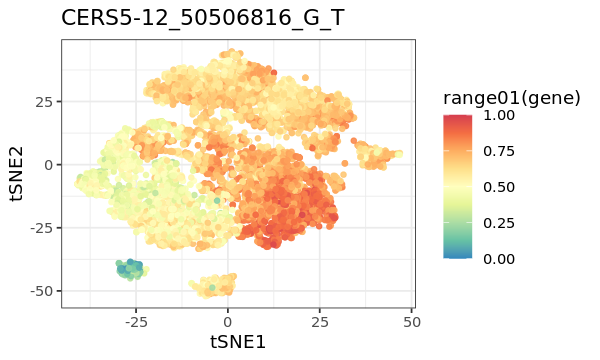

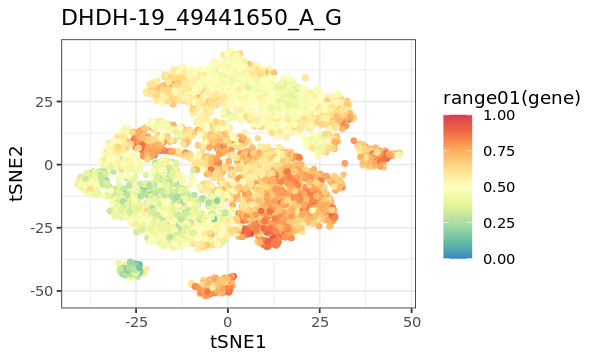

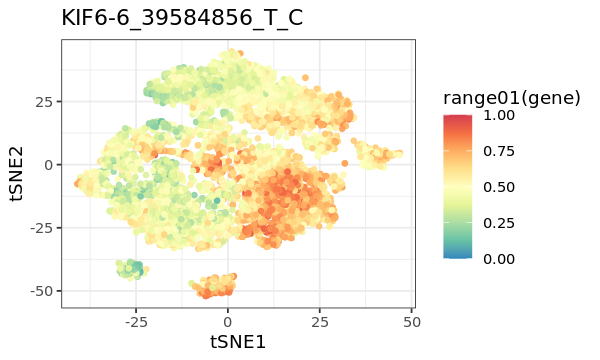

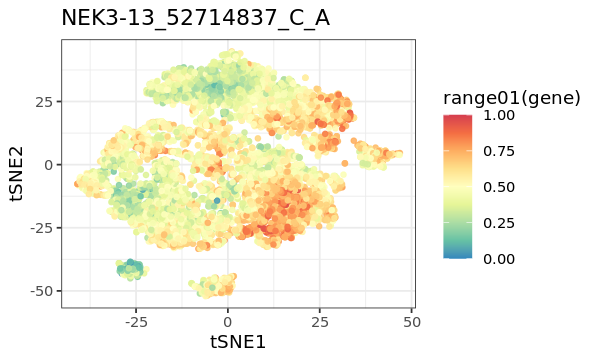

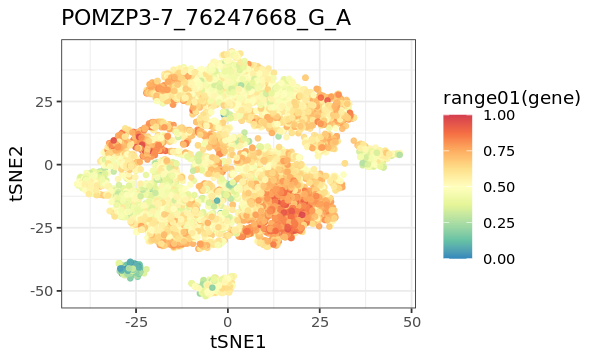

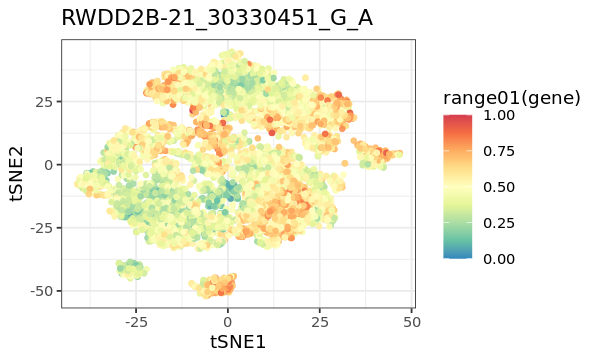

In [32]:
cluster='8'
genes = gsub("_-","-",df_clusters[df_clusters$label == cluster,"gene"])
for (gene in genes){
    df_to_plot = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = tSNE1, y = tSNE2, col = range01(gene))) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

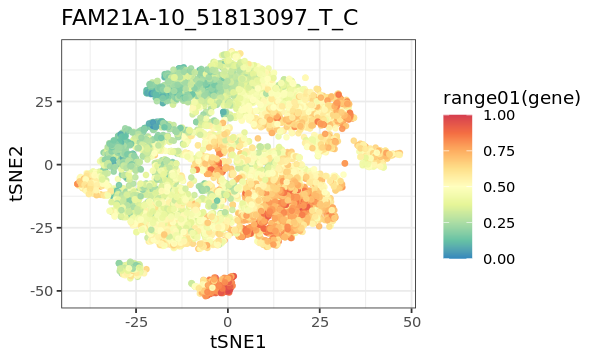

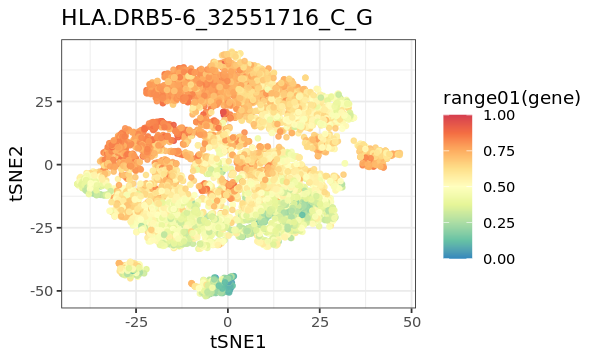

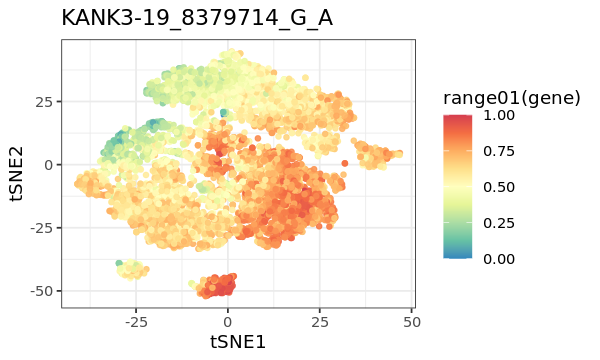

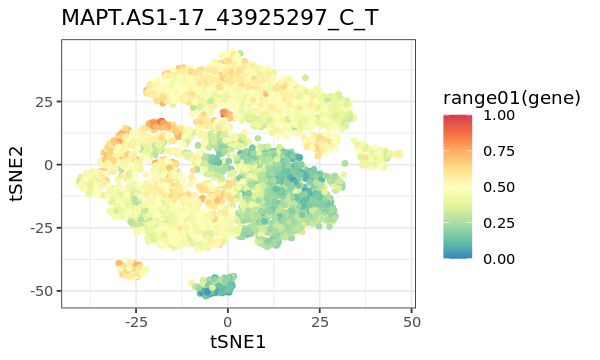

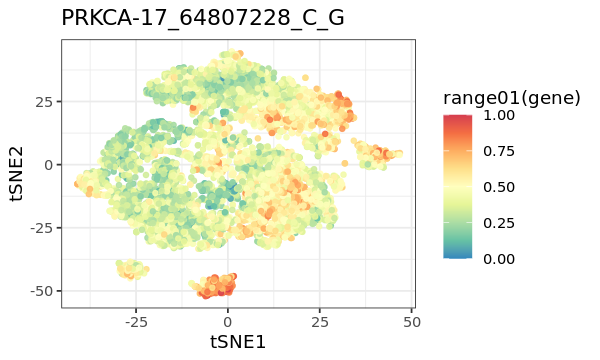

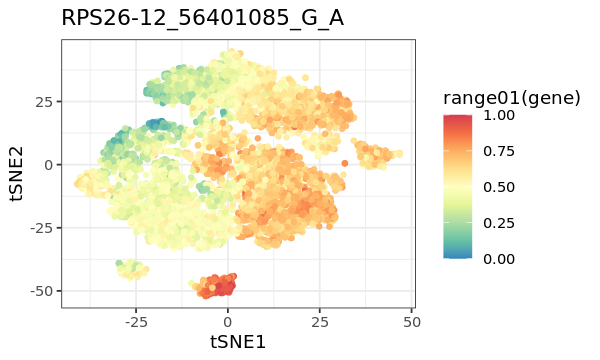

In [33]:
cluster='2'
genes = gsub("_-","-",df_clusters[df_clusters$label == cluster,"gene"])
for (gene in genes){
    df_to_plot = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = tSNE1, y = tSNE2, col = range01(gene))) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}

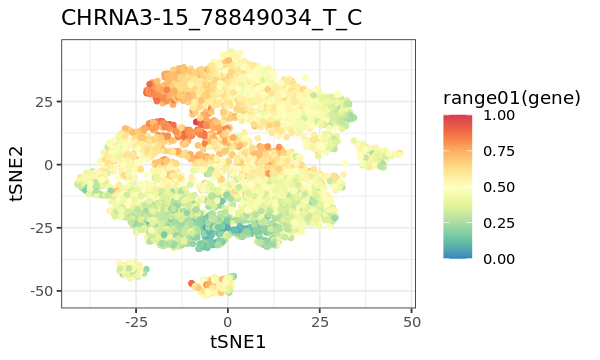

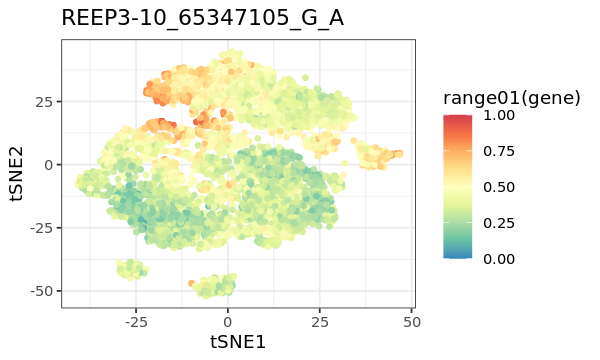

In [34]:
cluster='9'
genes = gsub("_-","-",df_clusters[df_clusters$label == cluster,"gene"])
for (gene in genes){
    df_to_plot = cbind(df_pcs[,c("tSNE1","tSNE2")], data.frame(gene = df[,gene]))
    p = ggplot(df_to_plot, aes(x = tSNE1, y = tSNE2, col = range01(gene))) + geom_point(alpha = 0.9, size = 1.2) + ggtitle(gene)
    p = p + theme_bw() + scale_colour_gradientn(colors = rev(brewer.pal(9,"Spectral")))
    print(p)
}